In [127]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as mplt

import plotly as plt
from mpl_toolkits.mplot3d import Axes3D

In [128]:
df = pd.read_excel("DTSV_data_gaps.xlsx")

In [129]:
df = df.drop(0)
df = df.rename(columns={"Unnamed: 0" : "depth"})

In [130]:
df.head()

,depth,18/03/2016 08:59:20,18/03/2016 09:00:22,18/03/2016 09:01:24,18/03/2016 09:02:26,18/03/2016 09:03:27,18/03/2016 09:04:30,18/03/2016 09:05:31,18/03/2016 09:06:33,18/03/2016 09:07:35,...,18/03/2016 18:51:59,18/03/2016 18:53:00,18/03/2016 18:54:02,18/03/2016 18:55:04,18/03/2016 18:56:06,18/03/2016 18:57:08,18/03/2016 18:58:10,18/03/2016 18:59:11,18/03/2016 19:00:13,18/03/2016 19:01:15
1,0.101,1.236,1.052,1.065,0.912,0.936,1.062,0.913,0.838,0.844,...,16.566,16.572,16.685,17.029,16.939,16.914,16.744,16.775,17.288,17.251
2,0.227,1.074,0.973,0.927,0.748,0.818,0.933,0.885,0.809,0.796,...,16.44,16.425,16.78,16.906,16.827,16.887,16.613,16.878,17.134,17.259
3,0.354,1.19,0.914,0.684,0.707,0.85,1.094,0.937,0.869,0.653,...,16.254,16.553,16.601,16.634,16.729,16.821,16.525,16.849,16.99,17.187
4,0.48,1.2,0.907,0.602,0.749,1.048,1.212,0.99,0.982,0.65,...,15.913,16.021,16.255,16.285,16.35,16.417,16.355,16.43,16.788,16.831
5,0.607,0.959,0.756,0.803,0.716,1.055,0.969,1.186,0.896,0.816,...,15.249,15.569,15.881,16.116,15.916,15.887,15.679,15.986,16.278,16.338


In [131]:
t = pd.to_datetime(df.columns[1:])
colorscale = [[0, 'gold'], [0.5, 'mediumturquoise'], [1, 'lightsalmon']]

fig = plt.graph_objects.Figure()
fig = plt.graph_objects.Figure(data=[plt.graph_objects.Surface( z=df.values[1:,10:], colorscale = colorscale)])
fig.update_traces(contours_z=dict(show=True, usecolormap=True,
highlightcolor="limegreen", project_z=True))
fig.update_layout(scene = dict(
xaxis = dict(
backgroundcolor="rgb(200, 200, 230)",
gridcolor="white",
showbackground=True,
zerolinecolor="white",),
yaxis = dict(
backgroundcolor="rgb(230, 200,230)",
gridcolor="white",
showbackground=True,
zerolinecolor="white"),
zaxis = dict(
backgroundcolor="rgb(230, 230,200)",
gridcolor="white",
showbackground=True,
zerolinecolor="white",),),
width=900,
margin=dict(
r=0, l=100,
b=0, t=30),
title='Данные'
)
fig.show()

In [132]:
dft = df.T

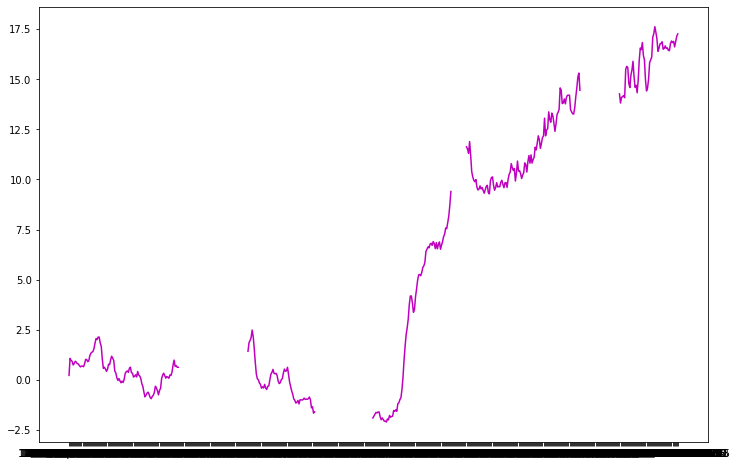

In [133]:
mplt.figure(figsize=(12, 8))
mplt.plot(df.columns, df.iloc[1], '-m')

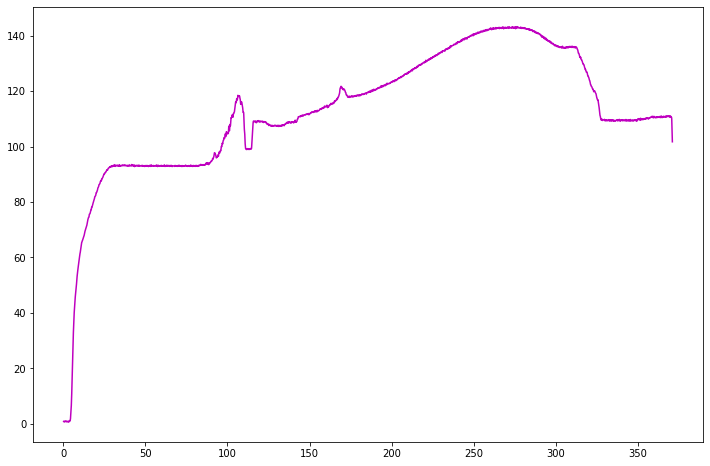

In [134]:
mplt.figure(figsize=(12, 8))
mplt.plot(dft.iloc[0], dft.iloc[9], '-m')

In [135]:
y = dft.loc[df.isnull().any()].T
X = dft.loc[df.notnull().any()].T

In [138]:
unidata = X.iloc[1][1:]
unidata.index = X.columns[1:]

array([<matplotlib.axes._subplots.AxesSubplot object at 0x000001C20943B0C8>],
      dtype=object)

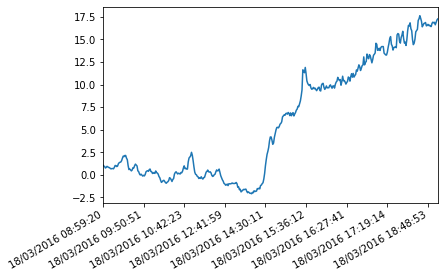

In [145]:
unidata.plot(subplots=True)

In [146]:
uni_data = unidata.values

In [147]:
uni_train_mean = uni_data.mean()
uni_train_std = uni_data.std()

In [ ]:
uni_data = (uni_data-uni_train_mean)/uni_train_std

In [ ]:
def univariate_data(dataset, start_index, end_index, history_size, target_size):
  data = []
  labels = []

  start_index = start_index + history_size
  if end_index is None:
    end_index = len(dataset) - target_size

  for i in range(start_index, end_index):
    indices = range(i-history_size, i)
    data.append(np.reshape(dataset[indices], (history_size, 1)))
    labels.append(dataset[i+target_size])
  return np.array(data), np.array(labels)

In [ ]:
univariate_past_history = 500
univariate_future_target = 0

x_train_uni, y_train_uni = univariate_data(uni_data, 0, 414,
                                           univariate_past_history,
                                           univariate_future_target)
x_val_uni, y_val_uni = univariate_data(uni_data, 414, None,
                                       univariate_past_history,
                                       univariate_future_target)

In [ ]:
def create_time_steps(length):
  return list(range(-length, 0))